In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
import warnings
from collections import Counter
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams["font.sans-serif"] = "Arial"
warnings.filterwarnings('ignore')
sc.settings.set_figure_params(dpi=80, dpi_save=300, figsize=(4, 4))
%config InlineBackend.figure_format = 'retina'
import os
from scipy.io import mmread
from os.path import join, exists, split
from os import listdir
from typing import Union
import re
from scipy import stats
sc.settings.n_jobs=8

In [2]:
import scanpy as sc

In [12]:
B = sc.read_h5ad('c')

In [3]:
cd4t = sc.read_h5ad('../wzy_refined_cluters/CD4_T_20220923.h5ad')

In [47]:
sc.tl.leiden(cd4t,resolution=0.12)

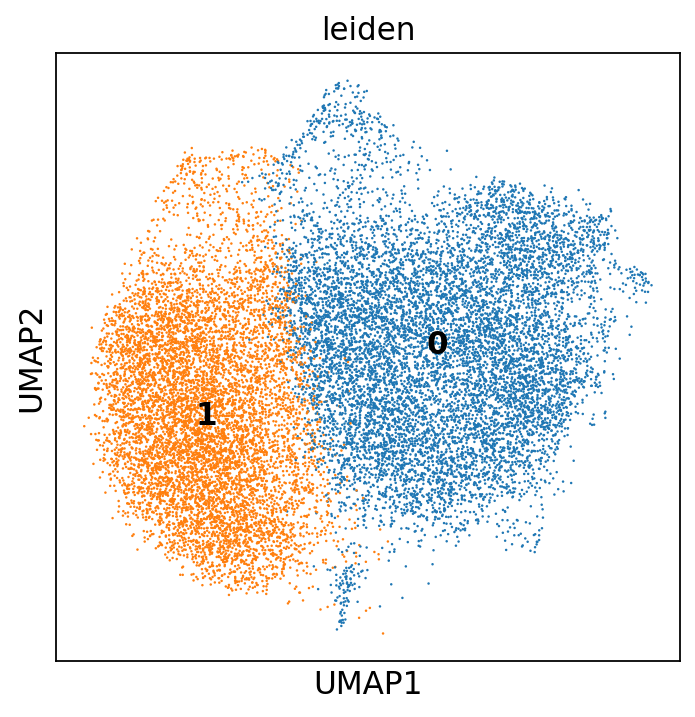

In [48]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(cd4t,color='leiden',size=5,legend_loc='on data')

In [54]:
new_cluster_names = ['CD4_T_c02_S100A4','CD4_T_c01_CCR7']
cd4t.rename_categories('leiden', new_cluster_names)

In [57]:
cd4t.write('./refined_results/cd4t_20221113.h5ad') 

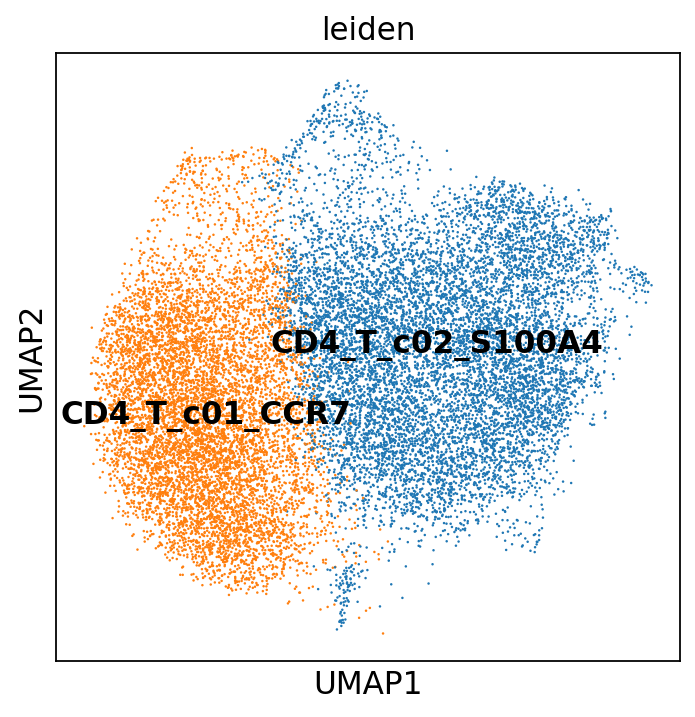

In [55]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(cd4t,color='leiden',size=5,legend_loc='on data')

In [50]:
cd4t.uns['log1p']["base"] = None
sc.tl.rank_genes_groups(cd4t, 'leiden', method='wilcoxon')
result = cd4t.uns['rank_genes_groups']
groups = result['names'].dtype.names
deg_data = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores']})=

,0_n,0_s,1_n,1_s
0,S100A4,85.550858,CCR7,53.550610
1,SH3BGRL3,66.364906,EEF1B2,46.907154
2,ITGB1,65.300835,LEF1,45.975285
3,S100A11,63.888336,NACA,42.877922
4,ANXA1,59.233604,SELL,38.289627
5,B2M,56.304195,SARAF,35.975613
6,AHNAK,54.630375,NPM1,35.400131
7,S100A10,54.182362,PIK3IP1,33.565468
8,CRIP1,53.972496,TXK,33.473305
9,IL32,50.074757,TSHZ2,33.233250


In [51]:
deg_data.head(10)

,0_n,0_s,1_n,1_s
0,S100A4,85.550858,CCR7,53.550610
1,SH3BGRL3,66.364906,EEF1B2,46.907154
2,ITGB1,65.300835,LEF1,45.975285
3,S100A11,63.888336,NACA,42.877922
4,ANXA1,59.233604,SELL,38.289627
5,B2M,56.304195,SARAF,35.975613
6,AHNAK,54.630375,NPM1,35.400131
7,S100A10,54.182362,PIK3IP1,33.565468
8,CRIP1,53.972496,TXK,33.473305
9,IL32,50.074757,TSHZ2,33.233250


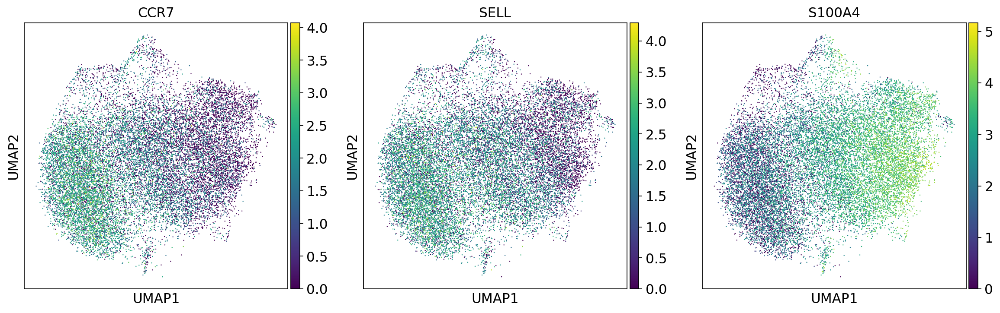

In [53]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(cd4t,color=['CCR7','SELL','S100A4'],size=5,legend_loc='on data')

In [10]:
cd8t = sc.read_h5ad('C:/Users/james/D：/CD8_T_20220925.h5ad')
nk = sc.read_h5ad('C:/Users/james/D：/NK_20220911.h5ad')

In [11]:
cd4t = sc.read_h5ad('C:/Users/james/D：/cd4t_20221113.h5ad')

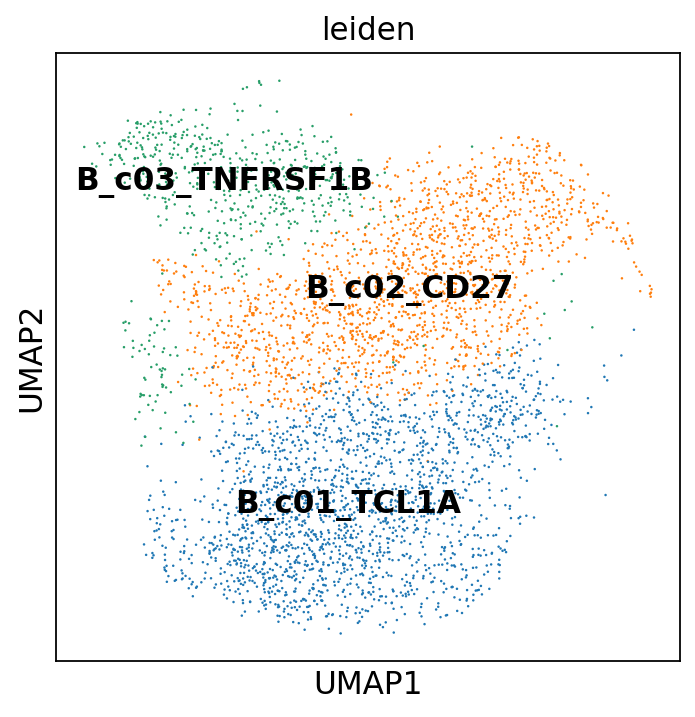

In [5]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(B,color='leiden',size=5,legend_loc='on data')

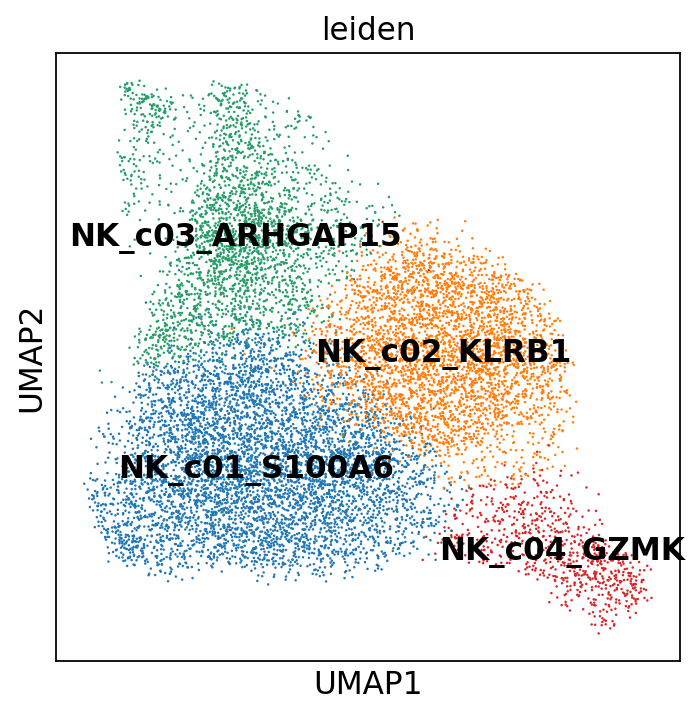

In [9]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(nk,color='leiden',size=5,legend_loc='on data')

In [2]:
monocytes = sc.read_h5ad('C:/Users/james/D：/monocytes_20221113.h5ad')

In [9]:
dcs = sc.read_h5ad('C:/Users/james/D：/dcs_20221113.h5ad')

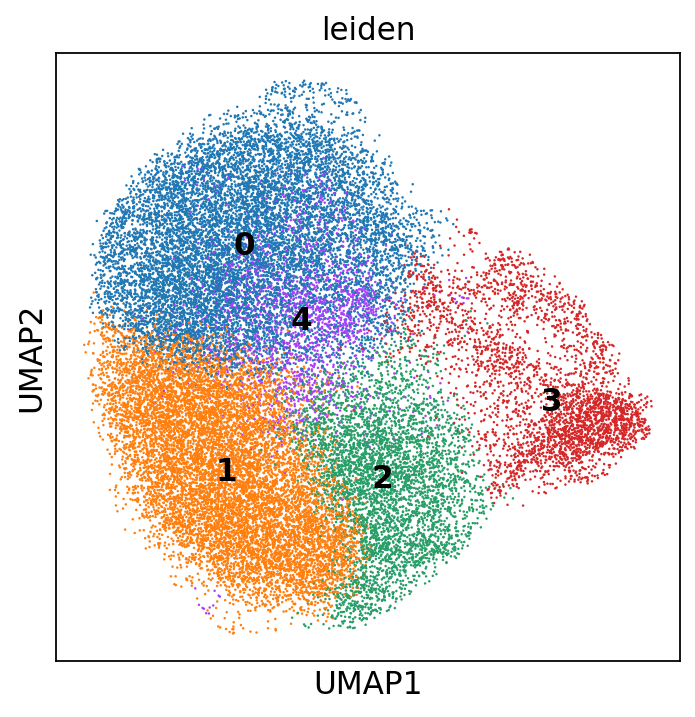

In [73]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(monocytes,color='leiden',size=5,legend_loc='on data')

In [3]:
new_cluster_names = ['Mono_c02_IL1B_CCL3','Mono_c01','Mono_c03_HLA-DRA_ISG15','Mono_c05_CD16','Mono_c04_PF4_PPBP']
monocytes.rename_categories('leiden', new_cluster_names)

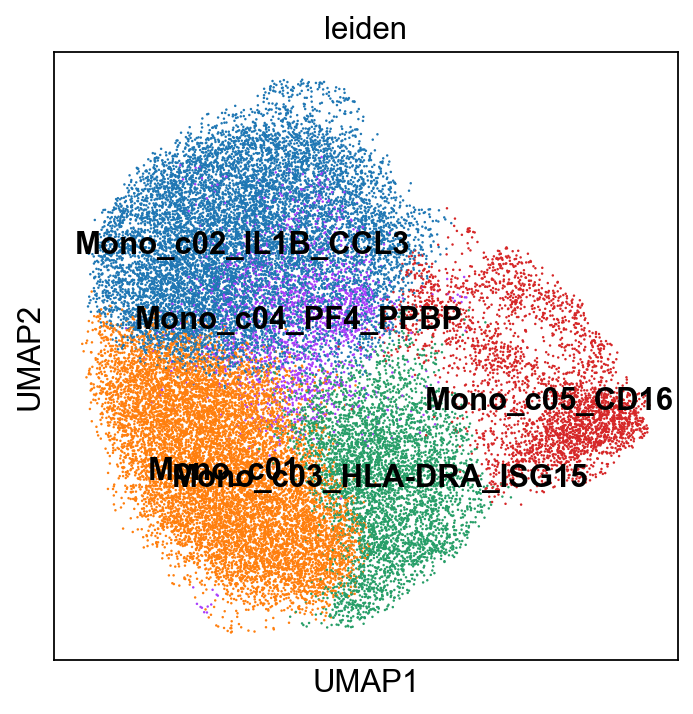

In [4]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(monocytes,color='leiden',size=5,legend_loc='on data')

In [5]:
monocytes.write('C:/Users/james/D：/monocytes_20221117.h5ad') 

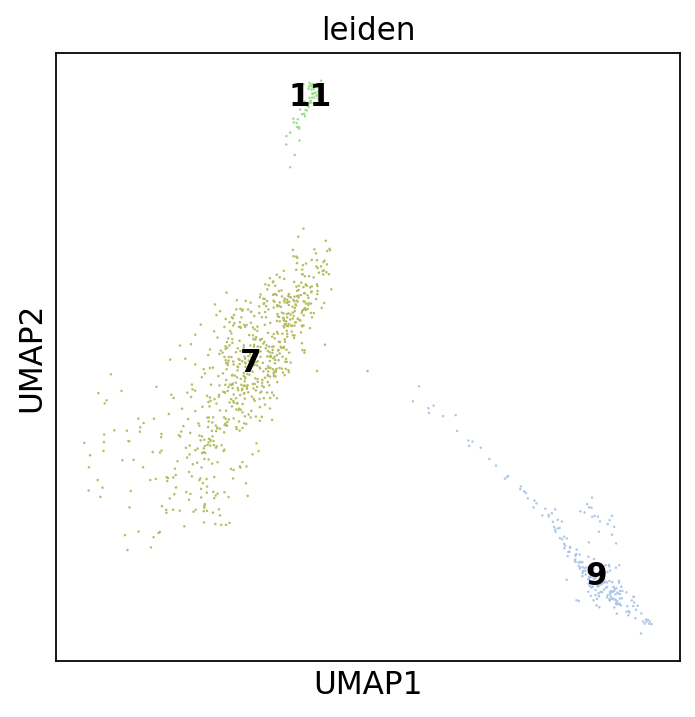

In [72]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(dcs,color='leiden',size=5,legend_loc='on data')

In [78]:
new_cluster_names = ['DC_c01_CD1C','DC_c03_CLEC4C','DC_c02_CLEC9A']
dcs.rename_categories('leiden', new_cluster_names)

Omitting rank_genes_groups/logfoldchanges as old categories do not match.
Omitting rank_genes_groups/names as old categories do not match.
Omitting rank_genes_groups/pvals as old categories do not match.
Omitting rank_genes_groups/pvals_adj as old categories do not match.
Omitting rank_genes_groups/scores as old categories do not match.


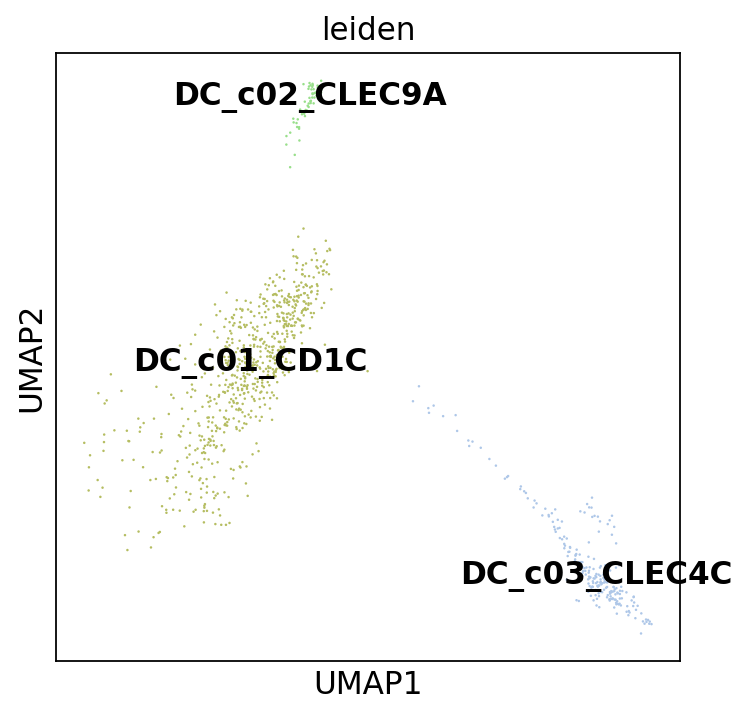

In [79]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(dcs,color='leiden',size=5,legend_loc='on data')

In [80]:
dcs.write('./refined_results/dcs_20221113.h5ad') 

In [3]:
integrated = sc.read_h5ad('C:/Users/james/D：/integrated_20220924.h5ad')

In [14]:
new_names = integrated.obs.loc[integrated.obs.leiden.isin(['c12_Treg','c10_Platelet','c14_Neutrophil','c04_NK']),].index

In [15]:
len(new_names)

15422

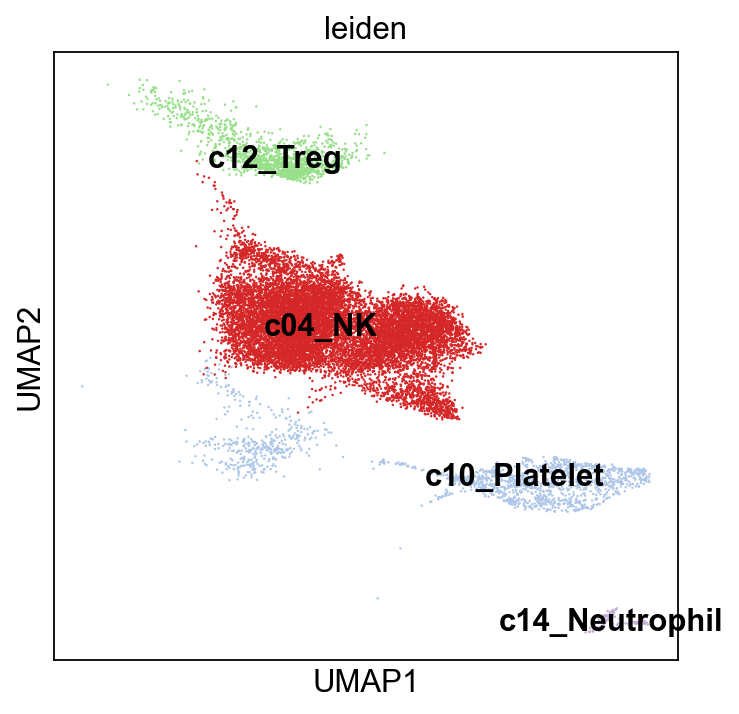

In [16]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(integrated[new_names,],color='leiden',size=5,legend_loc='on data')

In [17]:
new_names = new_names.append(B.obs.index)
new_names = new_names.append(cd4t.obs.index)
new_names = new_names.append(cd8t.obs.index)
new_names = new_names.append(monocytes.obs.index)
new_names = new_names.append(dcs.obs.index)

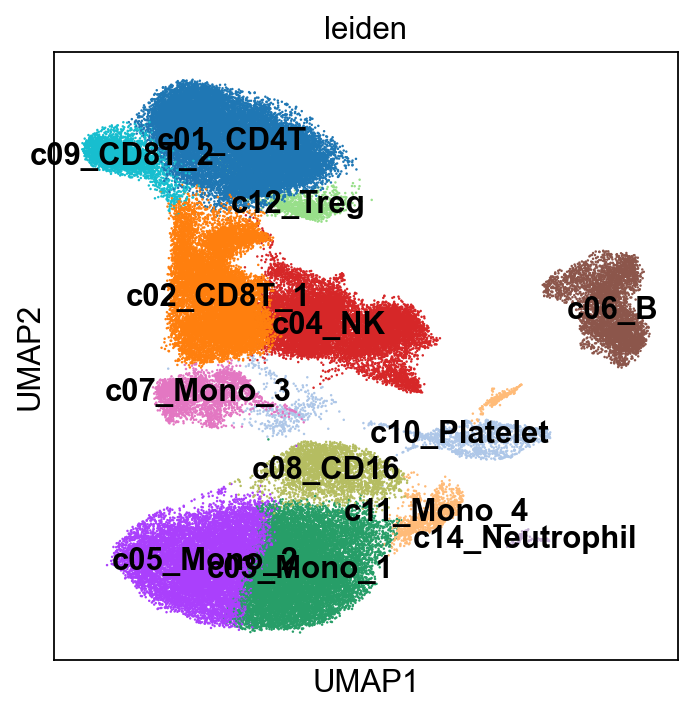

In [18]:
sc.settings.set_figure_params(dpi=80, figsize=(5, 5))
sc.pl.umap(integrated[new_names,],color='leiden',size=5,legend_loc='on data')

In [19]:
integrated = integrated[new_names,]

In [20]:
integrated.obs['refined_cluters'] = '0'

In [21]:
for i in range(0,integrated.obs.shape[0]):
    if 'Treg' in integrated.obs.leiden[i]:
        integrated.obs.refined_cluters[i] = 'Treg'
    elif 'Platelet' in integrated.obs.leiden[i]:
        integrated.obs.refined_cluters[i] = 'Platelet'
    elif 'Neutrophil' in integrated.obs.leiden[i]:
        integrated.obs.refined_cluters[i] = 'Neutrophil'
    elif 'NK' in integrated.obs.leiden[i]:
        integrated.obs.refined_cluters[i] = 'NK'
    elif 'CD4T' in integrated.obs.leiden[i]:
        temp_index = integrated.obs.index[i]
        if temp_index in cd4t.obs.index:
            integrated.obs.refined_cluters[i] = cd4t.obs.loc[temp_index]['leiden']
        elif temp_index in cd8t.obs.index:
            integrated.obs.refined_cluters[i] = cd8t.obs.loc[temp_index]['leiden']
    elif 'CD8T' in integrated.obs.leiden[i]:
        temp_index = integrated.obs.index[i]
        if temp_index in cd4t.obs.index:
            integrated.obs.refined_cluters[i] = cd4t.obs.loc[temp_index]['leiden']
        elif temp_index in cd8t.obs.index:
            integrated.obs.refined_cluters[i] = cd8t.obs.loc[temp_index]['leiden']
    elif 'B' in integrated.obs.leiden[i]:
        temp_index = integrated.obs.index[i]
        integrated.obs.refined_cluters[i] = B.obs.loc[temp_index]['leiden']
    elif 'Mono' in integrated.obs.leiden[i] or 'CD16' in integrated.obs.leiden[i]:
        temp_index = integrated.obs.index[i]
        if temp_index in monocytes.obs.index:
            integrated.obs.refined_cluters[i] = monocytes.obs.loc[temp_index]['leiden']
        elif temp_index in dcs.obs.index:
            integrated.obs.refined_cluters[i] = dcs.obs.loc[temp_index]['leiden']

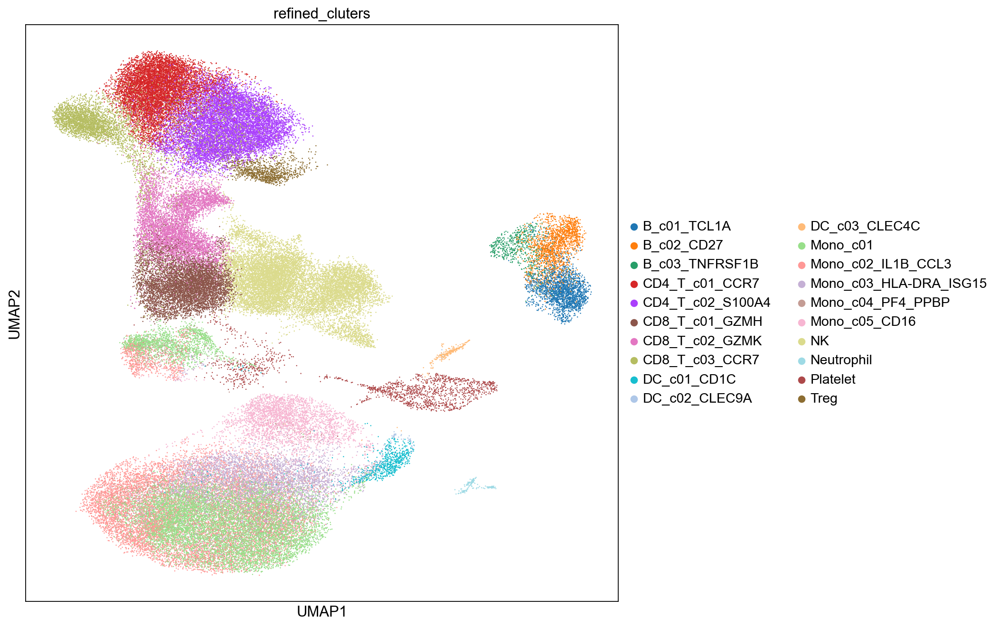

In [22]:
sc.settings.set_figure_params(dpi=80, figsize=(10, 10))
sc.pl.umap(integrated,color='refined_cluters',size=5)

In [23]:
integrated.write('C:/Users/james/D：/integrated_20221117.h5ad') 

In [3]:
integrated = sc.read_h5ad('C:/Users/james/D：/integrated_20221117.h5ad')

In [3]:
integrated.obs

,n_genes,batch,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,doublet,doublet_score,condition,source,leiden,refined_cluters
AAACCCATCTCAACCC-1_sap1,1939,sap1,1859,3709.0,151.0,4.071178,0,6.350207e-01,sap,ours,c04_NK,NK
AAACGAACACCTTCCA-1_sap1,1417,sap1,1347,2640.0,159.0,6.022727,0,6.715557e-05,sap,ours,c04_NK,NK
AAACGAACACGGGTAA-1_sap1,1287,sap1,1249,2198.0,141.0,6.414922,0,5.482184e-07,sap,ours,c04_NK,NK
AAACGAAGTGCAATAA-1_sap1,2014,sap1,1929,3948.0,144.0,3.647416,0,4.633627e-07,sap,ours,c04_NK,NK
AAACGAAGTGCTTATG-1_sap1,1901,sap1,1823,3749.0,165.0,4.401174,0,2.832003e-10,sap,ours,c04_NK,NK
...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTAGGCAAGAGGCT-1_c6,2605,c6,2561,9396.0,339.0,3.607918,0,1.271075e+01,control,fimmu,c11_Mono_4,DC_c01_CD1C
TTTATGCGTACTTCTT-1_c6,1770,c6,1734,5445.0,201.0,3.691460,0,1.271075e+01,control,fimmu,c11_Mono_4,DC_c01_CD1C
TTTCCTCCACATGGGA-1_c6,1628,c6,1598,4566.0,129.0,2.825230,0,1.271075e+01,control,fimmu,c11_Mono_4,DC_c01_CD1C
TTTGCGCTCCTATTCA-1_c6,2250,c6,2216,7779.0,129.0,1.658311,0,1.271075e+01,control,fimmu,c11_Mono_4,DC_c01_CD1C


In [4]:
leiden_cmap = {'B_c01_TCL1A': '#609ea0','B_c02_CD27': '#1f8c43','B_c03_TNFRSF1B': '#7f8133','CD4_T_c01_CCR7': '#f05151','CD4_T_c02_S100A4': '#ffbb78','CD8_T_c01_GZMH': '#ff7f0e',
    'CD8_T_c02_GZMK': '#f16ba9','CD8_T_c03_CCR7': '#c8ab04','DC_c01_CD1C': '#e2b4d3','DC_c02_CLEC9A': '#c46da1','DC_c03_CLEC4C': '#8e2680',
   'Mono_c01': '#bdbcdc','Mono_c02_IL1B_CCL3': '#37c0c5','Mono_c03_HLA-DRA_ISG15': '#2c86f8','Mono_c04_PF4_PPBP': '#292c7c','Mono_c05_CD16': '#98df8a',
     'NK': '#8c574c',
 'Neutrophil': '#4fb848',
 'Platelet': '#ee2123',
 'Treg': '#ba5b6f'}

In [3]:
condition_cmap = {'control': '#d9d9d9','sap': '#2b7bb3'}

In [40]:
leiden_cmap

{'B_c01_TCL1A': '#609ea0',
 'B_c02_CD27': '#1f8c43',
 'B_c03_TNFRSF1B': '#7f8133',
 'CD4_T_c01_CCR7': '#f05151',
 'CD4_T_c02_S100A4': '#ffbb78',
 'CD8_T_c01_GZMH': '#ff7f0e',
 'CD8_T_c02_GZMK': '#f16ba9',
 'CD8_T_c03_CCR7': '#c8ab04',
 'DC_c01_CD1C': '#e2b4d3',
 'DC_c02_CLEC9A': '#c46da1',
 'DC_c03_CLEC4C': '#8e2680',
 'Mono_c01': '#bdbcdc',
 'Mono_c02_IL1B_CCL3': '#37c0c5',
 'Mono_c03_HLA-DRA_ISG15': '#2c86f8',
 'Mono_c04_PF4_PPBP': '#292c7c',
 'Mono_c05_CD16': '#98df8a',
 'NK': '#8c574c',
 'Neutrophil': '#4fb848',
 'Platelet': '#ee2123',
 'Treg': '#ba5b6f'}

meta NOT subset; don't know how to subset; dropped


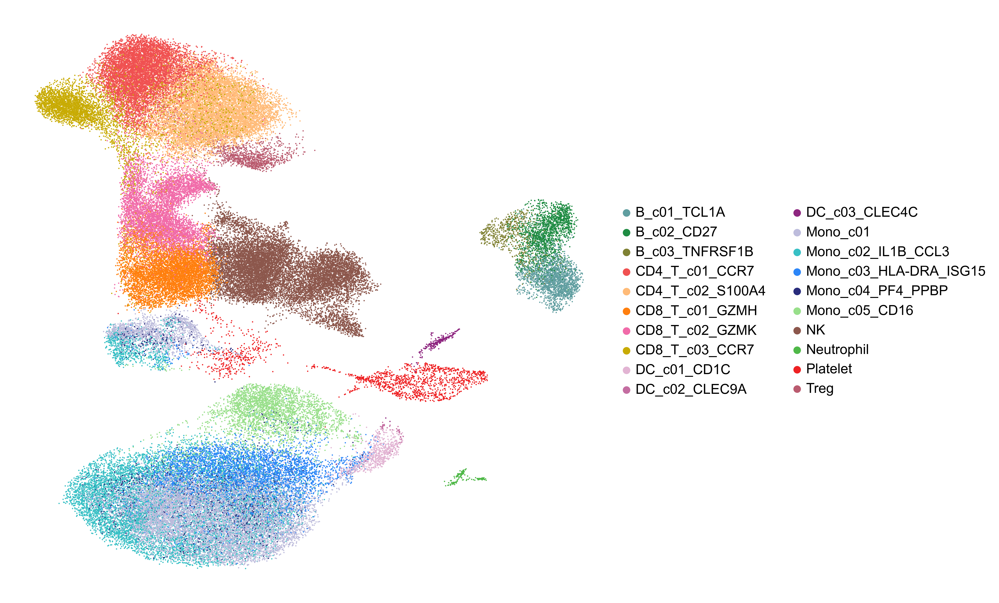

In [5]:
sc.settings.set_figure_params(dpi=200, figsize=(10, 10))
sc.pl.umap(integrated,color='refined_cluters',palette=leiden_cmap,size=6,title='', frameon=False,save='integrated.UMAP')

In [6]:
sc.pl.umap

<function scanpy.plotting._tools.scatterplots.umap(adata: anndata._core.anndata.AnnData, *, color: Union[str, Sequence[str], NoneType] = None, gene_symbols: Optional[str] = None, use_raw: Optional[bool] = None, sort_order: bool = True, edges: bool = False, edges_width: float = 0.1, edges_color: Union[str, Sequence[float], Sequence[str]] = 'grey', neighbors_key: Optional[str] = None, arrows: bool = False, arrows_kwds: Optional[Mapping[str, Any]] = None, groups: Optional[str] = None, components: Union[str, Sequence[str]] = None, dimensions: Union[Tuple[int, int], Sequence[Tuple[int, int]], NoneType] = None, layer: Optional[str] = None, projection: Literal['2d', '3d'] = '2d', scale_factor: Optional[float] = None, color_map: Union[matplotlib.colors.Colormap, str, NoneType] = None, cmap: Union[matplotlib.colors.Colormap, str, NoneType] = None, palette: Union[str, Sequence[str], cycler.Cycler, NoneType] = None, na_color: Union[str, Tuple[float, ...]] = 'lightgray', na_in_legend: bool = True,

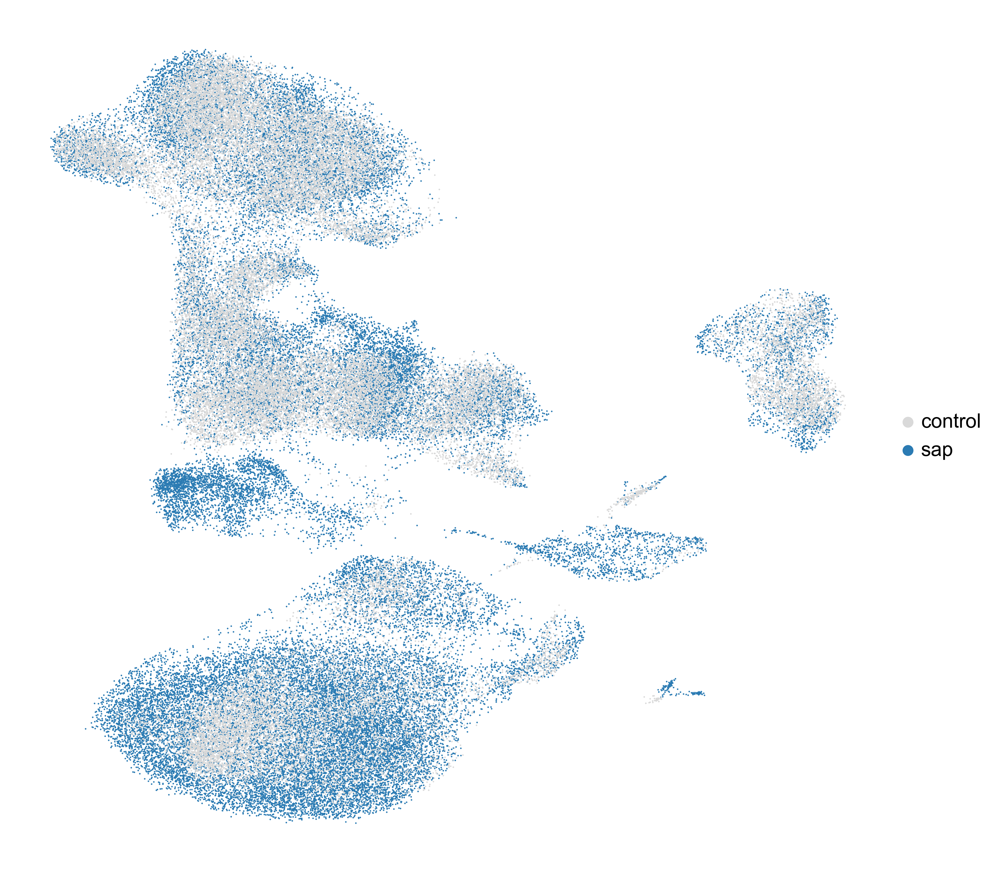

In [4]:
sc.settings.set_figure_params(dpi=200, figsize=(10, 10))
sc.pl.umap(integrated,color=['condition'],palette=condition_cmap,size=4,title='', frameon=False,save='integrated_condition1.UMAP')

In [3]:
control = integrated.obs.loc[integrated.obs.condition.isin(['control']),].index

In [7]:
sap = integrated.obs.loc[integrated.obs.condition.isin(['sap']),].index

In [5]:
control = integrated[control,]

In [6]:
control.obs.refined_cluters.value_counts()

NK                        6164
CD4_T_c02_S100A4          5627
CD4_T_c01_CCR7            4566
Mono_c01                  4464
CD8_T_c01_GZMH            4018
CD8_T_c02_GZMK            3554
CD8_T_c03_CCR7            2532
Mono_c03_HLA-DRA_ISG15    1591
B_c01_TCL1A               1205
Mono_c05_CD16             1002
B_c02_CD27                 965
Treg                       791
Mono_c02_IL1B_CCL3         523
DC_c01_CD1C                370
B_c03_TNFRSF1B             279
DC_c03_CLEC4C              171
Platelet                   153
Mono_c04_PF4_PPBP           40
Neutrophil                  29
DC_c02_CLEC9A               20
Name: refined_cluters, dtype: int64

In [10]:
len(control)

38064

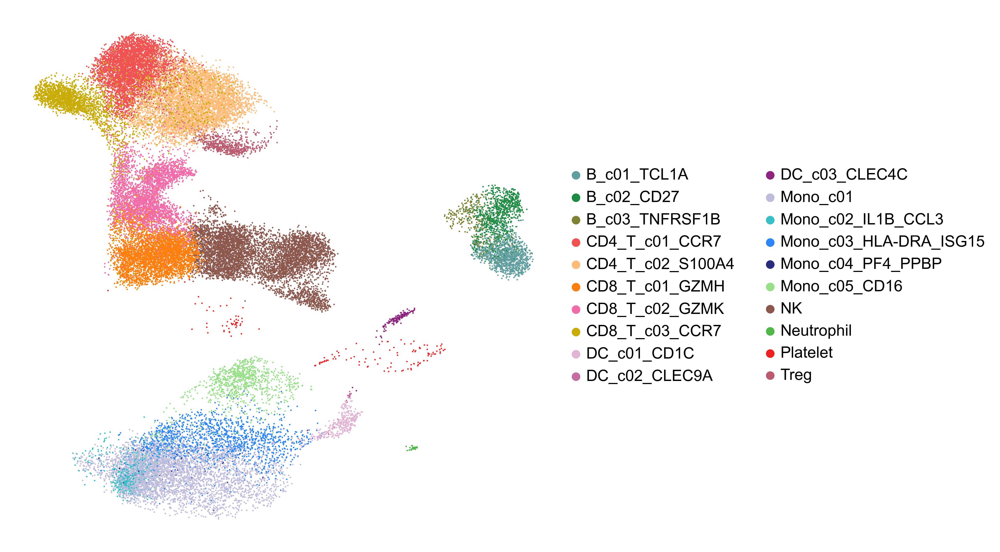

In [50]:
sc.settings.set_figure_params(dpi=200, figsize=(8, 8))
sc.pl.umap(integrated[control],color=['refined_cluters'],palette=leiden_cmap,size=6, title='', frameon=False,save='integrated_control.UMAP')

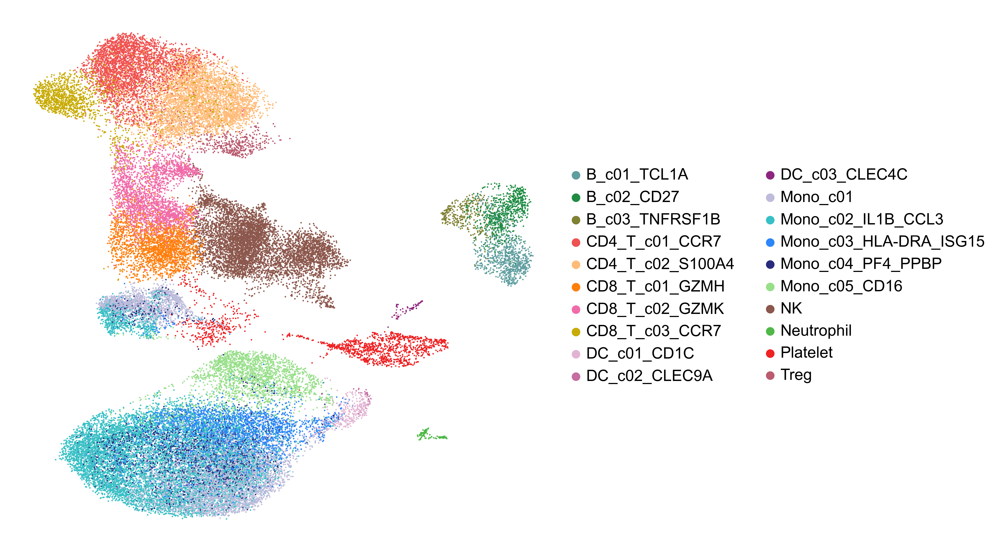

In [52]:
sc.settings.set_figure_params(dpi=200, figsize=(8, 8))
sc.pl.umap(integrated[sap],color=['refined_cluters'],palette=leiden_cmap,size=6, title='', frameon=False,save='integrated_sap.UMAP')

In [32]:
integrated.obs

,n_genes,batch,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,doublet,doublet_score,condition,source,leiden,refined_cluters
AAACCCATCTCAACCC-1_sap1,1939,sap1,1859,3709.0,151.0,4.071178,0,6.350207e-01,sap,ours,c04_NK,NK
AAACGAACACCTTCCA-1_sap1,1417,sap1,1347,2640.0,159.0,6.022727,0,6.715557e-05,sap,ours,c04_NK,NK
AAACGAACACGGGTAA-1_sap1,1287,sap1,1249,2198.0,141.0,6.414922,0,5.482184e-07,sap,ours,c04_NK,NK
AAACGAAGTGCAATAA-1_sap1,2014,sap1,1929,3948.0,144.0,3.647416,0,4.633627e-07,sap,ours,c04_NK,NK
AAACGAAGTGCTTATG-1_sap1,1901,sap1,1823,3749.0,165.0,4.401174,0,2.832003e-10,sap,ours,c04_NK,NK
...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTAGGCAAGAGGCT-1_c6,2605,c6,2561,9396.0,339.0,3.607918,0,1.271075e+01,control,fimmu,c11_Mono_4,DC_c01_CD1C
TTTATGCGTACTTCTT-1_c6,1770,c6,1734,5445.0,201.0,3.691460,0,1.271075e+01,control,fimmu,c11_Mono_4,DC_c01_CD1C
TTTCCTCCACATGGGA-1_c6,1628,c6,1598,4566.0,129.0,2.825230,0,1.271075e+01,control,fimmu,c11_Mono_4,DC_c01_CD1C
TTTGCGCTCCTATTCA-1_c6,2250,c6,2216,7779.0,129.0,1.658311,0,1.271075e+01,control,fimmu,c11_Mono_4,DC_c01_CD1C


In [33]:
import matplotlib.pyplot as plt

In [6]:
marker_genes_dict = {
    'B_c01_TCL1A': ['CD79A', 'TCL1A'],
    'B_c02_CD27': ['CD27'],
    'B_c03_TNFRSF1B': ['TNFRSF1B'],
    'CD4_T_c01_CCR7': ['CD3D', 'CCR7'],
    'CD4_T_c02_S100A4': ['CD3E','S100A4'],
    'CD8_T_c01_GZMH': ['CD8A','CD52','GZMH'],
    'CD8_T_c02_GZMK': ['NKG7','GZMK'],
    'CD8_T_c03_CCR7': ['CCR7'],
    'DC_c01_CD1C': ['CD1C'],
    'DC_c02_CLEC9A': ['CLEC9A'],
    'DC_c03_CLEC4C': ['CLEC4C'],
    'Mono_c01': ['CD14'],
    'Mono_c02_IL1B_CCL3': ['IL1B','CCL3'],
    'Mono_c03_HLA-DRA_ISG15': ['HLA-DRA','ISG15'],
    'Mono_c04_PF4_PPBP': ['PF4','PPBP'],
    'Mono_c05_CD16': ['FCGR3A'],
    'NK': ['GNLY','CCL5'],
    'Neutrophil': ['NAMPT','CSF3R'],
    'Platelet': ['PPBP','PF4'],
    'Treg': ['FOXP3'],
}

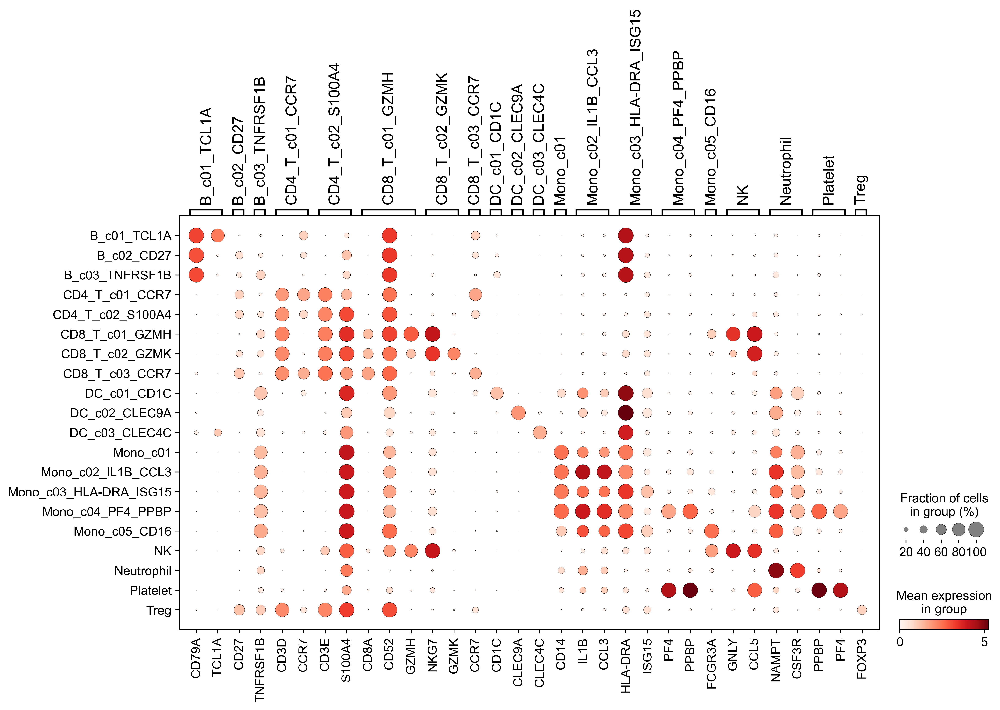

In [35]:
sc.settings.set_figure_params(dpi=200, figsize=(10, 10))
sc.pl.dotplot(integrated, marker_genes_dict, 'refined_cluters', dendrogram=False,save='integrated_heatmap_1.UMAP')